In [59]:
import pandas as pd
df = pd.read_csv('Customers.csv')

In [60]:
df.columns = map(str.lower, df.columns)
df.head()

,customerid,gender,age,annual income ($),spending score (1-100),profession,work experience,family size
0,1,Male,19,15000,39,Healthcare,1,4
1,2,Male,21,35000,81,Engineer,3,3
2,3,Female,20,86000,6,Engineer,1,1
3,4,Female,23,59000,77,Lawyer,0,2
4,5,Female,31,38000,40,Entertainment,2,6


Can we group customers? How?

Which group spends the most?

Why might they spend as much as they do?

What does our average customer look like?

In [61]:
df.columns

Index(['customerid', 'gender', 'age', 'annual income ($)',
       'spending score (1-100)', 'profession', 'work experience',
       'family size'],
      dtype='object')

In [62]:
df.gender.value_counts()

Female    1186
Male       814
Name: gender, dtype: int64

In [63]:
df.profession.value_counts()

Artist           612
Healthcare       339
Entertainment    234
Engineer         179
Doctor           161
Executive        153
Lawyer           142
Marketing         85
Homemaker         60
Name: profession, dtype: int64

In [64]:
df.age.mean()

48.96

In [65]:
print(f'annual income average: ',df['annual income ($)'].mean())
print(f'median income:', df['annual income ($)'].median())

annual income average:  110731.8215
median income: 110045.0


In [66]:
df.describe(include='all')

,customerid,gender,age,annual income ($),spending score (1-100),profession,work experience,family size
count,2000.000000,2000,2000.000000,2000.000000,2000.000000,1965,2000.000000,2000.000000
unique,NaN,2,NaN,NaN,NaN,9,NaN,NaN
top,NaN,Female,NaN,NaN,NaN,Artist,NaN,NaN
freq,NaN,1186,NaN,NaN,NaN,612,NaN,NaN
mean,1000.500000,NaN,48.960000,110731.821500,50.962500,NaN,4.102500,3.768500
std,577.494589,NaN,28.429747,45739.536688,27.934661,NaN,3.922204,1.970749
min,1.000000,NaN,0.000000,0.000000,0.000000,NaN,0.000000,1.000000
25%,500.750000,NaN,25.000000,74572.000000,28.000000,NaN,1.000000,2.000000
50%,1000.500000,NaN,48.000000,110045.000000,50.000000,NaN,3.000000,4.000000
75%,1500.250000,NaN,73.000000,149092.750000,75.000000,NaN,7.000000,5.000000


In [67]:
from pandas_profiling import ProfileReport

In [108]:
df_profile = ProfileReport(df)

In [109]:
df_profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [70]:
import seaborn as sns

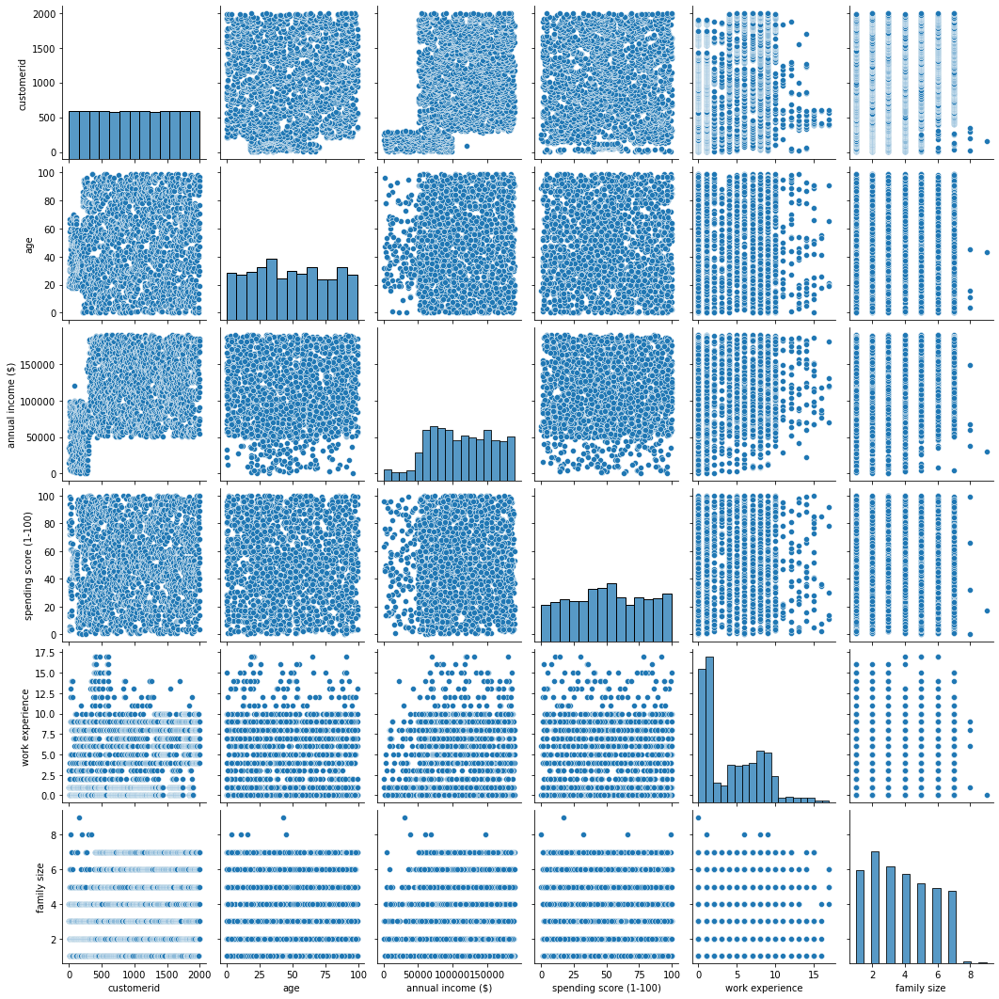

In [71]:
sns.pairplot(df)

# Average Customer: #
## Gender: Woman ##
### Age: 35 - 45 ###
### Income: 80,000 - 110,000 ###
### Profession: Artist/ Healthcare ###
### Family Size: 2 ###
### Work Experience: 3-4 Years ###

In [92]:
bin_edges = [0, 25, 50, 75, 100]
bin_labels = ['Low', 'Moderate', 'High', 'Very High']

# Bin the values in column 'col1'
df['score_binned'] = pd.cut(df['spending score (1-100)'], bins=bin_edges, labels=bin_labels, right=False)

In [93]:
low = df.copy()
lowest = ['Low']
low = low[low['score_binned'].isin(lowest)]

In [94]:
moderate = df.copy()
mod = ['Moderate']
moderate = moderate[moderate['score_binned'].isin(mod)]

In [115]:
high = df.copy()
higher = ['High']
high = high[high['score_binned'].isin(higher)]

In [116]:
top = df.copy()
highest = ['Very High']
top = top[top['score_binned'].isin(highest)]

In [119]:
low_profile = ProfileReport(low)
moderate_profile = ProfileReport(moderate)
high_profile = ProfileReport(high)
top_profile = ProfileReport(top)

In [120]:
low_profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [121]:
moderate_profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [122]:
high_profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [124]:
top_profile

In [126]:
df.to_csv('binned_df.csv')
top.to_csv('top_customers.csv')

# Top customer Profile: #
## Gender: Female ##
### Profession : Artist ###
### Age: Late 40's ###
### Income: 110,000 ###
### Family of : 3.7 ###
### Work Experince: 4 + Years ###